In [120]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

## One hot encoding

In [121]:

df=pd.read_csv('healthcare_dataset.csv')
df.head()

,Name,Age,Gender,Blood Type,Medical Condition,Date of Admission,Doctor,Hospital,Insurance Provider,Billing Amount,Room Number,Admission Type,Discharge Date,Medication,Test Results
0,Bobby JacksOn,30,Male,B-,Cancer,2024-01-31,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,328,Urgent,2024-02-02,Paracetamol,Normal
1,LesLie TErRy,62,Male,A+,Obesity,2019-08-20,Samantha Davies,Kim Inc,Medicare,33643.327287,265,Emergency,2019-08-26,Ibuprofen,Inconclusive
2,DaNnY sMitH,76,Female,A-,Obesity,2022-09-22,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,205,Emergency,2022-10-07,Aspirin,Normal
3,andrEw waTtS,28,Female,O+,Diabetes,2020-11-18,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,450,Elective,2020-12-18,Ibuprofen,Abnormal
4,adrIENNE bEll,43,Female,AB+,Cancer,2022-09-19,Kathleen Hanna,White-White,Aetna,14238.317814,458,Urgent,2022-10-09,Penicillin,Abnormal


In [122]:
df.drop(['Name','Room Number'],inplace=True,axis=1)

In [123]:
df.shape

(55500, 13)

In [124]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55500 entries, 0 to 55499
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Age                 55500 non-null  int64  
 1   Gender              55500 non-null  object 
 2   Blood Type          55500 non-null  object 
 3   Medical Condition   55500 non-null  object 
 4   Date of Admission   55500 non-null  object 
 5   Doctor              55500 non-null  object 
 6   Hospital            55500 non-null  object 
 7   Insurance Provider  55500 non-null  object 
 8   Billing Amount      55500 non-null  float64
 9   Admission Type      55500 non-null  object 
 10  Discharge Date      55500 non-null  object 
 11  Medication          55500 non-null  object 
 12  Test Results        55500 non-null  object 
dtypes: float64(1), int64(1), object(11)
memory usage: 5.5+ MB


In [125]:
df.describe()

,Age,Billing Amount
count,55500.000000,55500.000000
mean,51.539459,25539.316097
std,19.602454,14211.454431
min,13.000000,-2008.492140
25%,35.000000,13241.224652
50%,52.000000,25538.069376
75%,68.000000,37820.508436
max,89.000000,52764.276736


In [126]:
df.head()

,Age,Gender,Blood Type,Medical Condition,Date of Admission,Doctor,Hospital,Insurance Provider,Billing Amount,Admission Type,Discharge Date,Medication,Test Results
0,30,Male,B-,Cancer,2024-01-31,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,Urgent,2024-02-02,Paracetamol,Normal
1,62,Male,A+,Obesity,2019-08-20,Samantha Davies,Kim Inc,Medicare,33643.327287,Emergency,2019-08-26,Ibuprofen,Inconclusive
2,76,Female,A-,Obesity,2022-09-22,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,Emergency,2022-10-07,Aspirin,Normal
3,28,Female,O+,Diabetes,2020-11-18,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,Elective,2020-12-18,Ibuprofen,Abnormal
4,43,Female,AB+,Cancer,2022-09-19,Kathleen Hanna,White-White,Aetna,14238.317814,Urgent,2022-10-09,Penicillin,Abnormal


In [127]:
df.isnull().sum()

Age                   0
Gender                0
Blood Type            0
Medical Condition     0
Date of Admission     0
Doctor                0
Hospital              0
Insurance Provider    0
Billing Amount        0
Admission Type        0
Discharge Date        0
Medication            0
Test Results          0
dtype: int64

In [128]:
numeric=df.select_dtypes(include=['float64'])
numeric

,Billing Amount
0,18856.281306
1,33643.327287
2,27955.096079
3,37909.782410
4,14238.317814
...,...
55495,2650.714952
55496,31457.797307
55497,27620.764717
55498,32451.092358


<Axes: ylabel='Count'>

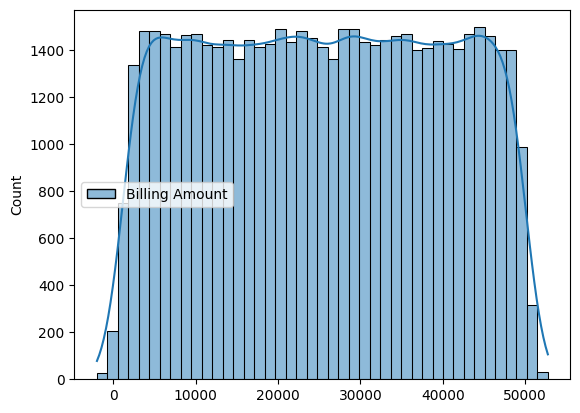

In [129]:
sns.histplot(numeric,kde=True)

In [130]:
def outlier_removal(data):
    outlier_indices={}

    for col in df.select_dtypes(include=[np.number]).columns:
        q1=np.percentile(df['Billing Amount'],25,method='midpoint')
        q3=np.percentile(df['Billing Amount'],75,method='midpoint')
        iqr=q3-q1
        lower=q1-(1.5*iqr)
        upper=q3+(1.5*iqr)

        outlier=df[(df[col]<lower) | (df[col]>upper)].index

        if len(outlier)>0:
            outlier_indices[col]=list(outlier)

    return outlier_indices
    

In [131]:
outliers=outlier_removal(df)
outliers

{}

<Axes: >

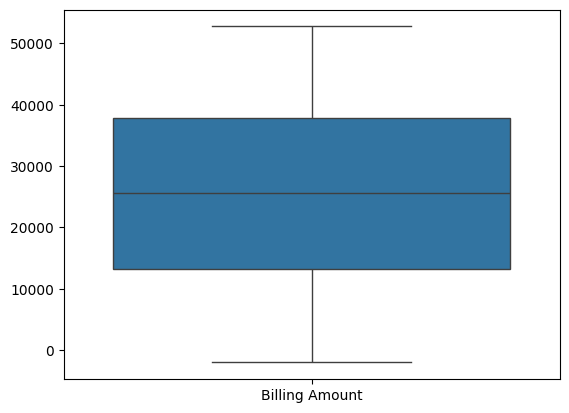

In [132]:
sns.boxplot(numeric)

In [133]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55500 entries, 0 to 55499
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Age                 55500 non-null  int64  
 1   Gender              55500 non-null  object 
 2   Blood Type          55500 non-null  object 
 3   Medical Condition   55500 non-null  object 
 4   Date of Admission   55500 non-null  object 
 5   Doctor              55500 non-null  object 
 6   Hospital            55500 non-null  object 
 7   Insurance Provider  55500 non-null  object 
 8   Billing Amount      55500 non-null  float64
 9   Admission Type      55500 non-null  object 
 10  Discharge Date      55500 non-null  object 
 11  Medication          55500 non-null  object 
 12  Test Results        55500 non-null  object 
dtypes: float64(1), int64(1), object(11)
memory usage: 5.5+ MB


In [134]:
df.nunique()

Age                      77
Gender                    2
Blood Type                8
Medical Condition         6
Date of Admission      1827
Doctor                40341
Hospital              39876
Insurance Provider        5
Billing Amount        50000
Admission Type            3
Discharge Date         1856
Medication                5
Test Results              3
dtype: int64

In [135]:
df['Medical Condition'].unique()

array(['Cancer', 'Obesity', 'Diabetes', 'Asthma', 'Hypertension',
       'Arthritis'], dtype=object)

In [136]:
df.drop(['Date of Admission','Discharge Date'],axis=1,inplace=True)

In [137]:
df['Admission Type'].unique()

array(['Urgent', 'Emergency', 'Elective'], dtype=object)

In [138]:
df1=pd.get_dummies(df['Gender'],drop_first=True).astype(int)
df1

,Male
0,1
1,1
2,0
3,0
4,0
...,...
55495,0
55496,0
55497,0
55498,1


In [139]:
df.drop('Gender',axis=1,inplace=True)

In [140]:
df=pd.concat([df,df1],axis=1)

In [141]:
df.tail()

,Age,Blood Type,Medical Condition,Doctor,Hospital,Insurance Provider,Billing Amount,Admission Type,Medication,Test Results,Male
55495,42,O+,Asthma,Joshua Jarvis,Jones-Thompson,Blue Cross,2650.714952,Elective,Penicillin,Abnormal,0
55496,61,AB-,Obesity,Taylor Sullivan,Tucker-Moyer,Cigna,31457.797307,Elective,Aspirin,Normal,0
55497,38,B+,Hypertension,Joe Jacobs DVM,"and Mahoney Johnson Vasquez,",UnitedHealthcare,27620.764717,Urgent,Ibuprofen,Abnormal,0
55498,43,O-,Arthritis,Kimberly Curry,"Jackson Todd and Castro,",Medicare,32451.092358,Elective,Ibuprofen,Abnormal,1
55499,53,O+,Arthritis,Dennis Warren,Henry Sons and,Aetna,4010.134172,Urgent,Ibuprofen,Abnormal,0


In [142]:
df.isnull().sum()

Age                   0
Blood Type            0
Medical Condition     0
Doctor                0
Hospital              0
Insurance Provider    0
Billing Amount        0
Admission Type        0
Medication            0
Test Results          0
Male                  0
dtype: int64

In [143]:
df['Admission Type'].unique()

array(['Urgent', 'Emergency', 'Elective'], dtype=object)

In [144]:
df1=pd.get_dummies(df['Admission Type'],drop_first=False).astype(int)
df1.head()

,Elective,Emergency,Urgent
0,0,0,1
1,0,1,0
2,0,1,0
3,1,0,0
4,0,0,1


In [145]:
df=pd.concat([df,df1],axis=1)
df.head()

,Age,Blood Type,Medical Condition,Doctor,Hospital,Insurance Provider,Billing Amount,Admission Type,Medication,Test Results,Male,Elective,Emergency,Urgent
0,30,B-,Cancer,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,Urgent,Paracetamol,Normal,1,0,0,1
1,62,A+,Obesity,Samantha Davies,Kim Inc,Medicare,33643.327287,Emergency,Ibuprofen,Inconclusive,1,0,1,0
2,76,A-,Obesity,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,Emergency,Aspirin,Normal,0,0,1,0
3,28,O+,Diabetes,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,Elective,Ibuprofen,Abnormal,0,1,0,0
4,43,AB+,Cancer,Kathleen Hanna,White-White,Aetna,14238.317814,Urgent,Penicillin,Abnormal,0,0,0,1


In [146]:
df.head()

,Age,Blood Type,Medical Condition,Doctor,Hospital,Insurance Provider,Billing Amount,Admission Type,Medication,Test Results,Male,Elective,Emergency,Urgent
0,30,B-,Cancer,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,Urgent,Paracetamol,Normal,1,0,0,1
1,62,A+,Obesity,Samantha Davies,Kim Inc,Medicare,33643.327287,Emergency,Ibuprofen,Inconclusive,1,0,1,0
2,76,A-,Obesity,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,Emergency,Aspirin,Normal,0,0,1,0
3,28,O+,Diabetes,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,Elective,Ibuprofen,Abnormal,0,1,0,0
4,43,AB+,Cancer,Kathleen Hanna,White-White,Aetna,14238.317814,Urgent,Penicillin,Abnormal,0,0,0,1


In [147]:
df.rename(columns={'Elective':'Admsn_type_elective','Emergency':'Admsn_type_emergency','Urgent':'Admsn_type_urgent'})

,Age,Blood Type,Medical Condition,Doctor,Hospital,Insurance Provider,Billing Amount,Admission Type,Medication,Test Results,Male,Admsn_type_elective,Admsn_type_emergency,Admsn_type_urgent
0,30,B-,Cancer,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,Urgent,Paracetamol,Normal,1,0,0,1
1,62,A+,Obesity,Samantha Davies,Kim Inc,Medicare,33643.327287,Emergency,Ibuprofen,Inconclusive,1,0,1,0
2,76,A-,Obesity,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,Emergency,Aspirin,Normal,0,0,1,0
3,28,O+,Diabetes,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,Elective,Ibuprofen,Abnormal,0,1,0,0
4,43,AB+,Cancer,Kathleen Hanna,White-White,Aetna,14238.317814,Urgent,Penicillin,Abnormal,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55495,42,O+,Asthma,Joshua Jarvis,Jones-Thompson,Blue Cross,2650.714952,Elective,Penicillin,Abnormal,0,1,0,0
55496,61,AB-,Obesity,Taylor Sullivan,Tucker-Moyer,Cigna,31457.797307,Elective,Aspirin,Normal,0,1,0,0
55497,38,B+,Hypertension,Joe Jacobs DVM,"and Mahoney Johnson Vasquez,",UnitedHealthcare,27620.764717,Urgent,Ibuprofen,Abnormal,0,0,0,1
55498,43,O-,Arthritis,Kimberly Curry,"Jackson Todd and Castro,",Medicare,32451.092358,Elective,Ibuprofen,Abnormal,1,1,0,0


In [148]:
df.drop('Admission Type',axis=1,inplace=True)

In [149]:
cols=list(df.columns)
cols.remove('Test Results')
cols.append('Test Results')
df=df[cols]

In [150]:
df.head()

,Age,Blood Type,Medical Condition,Doctor,Hospital,Insurance Provider,Billing Amount,Medication,Male,Elective,Emergency,Urgent,Test Results
0,30,B-,Cancer,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,Paracetamol,1,0,0,1,Normal
1,62,A+,Obesity,Samantha Davies,Kim Inc,Medicare,33643.327287,Ibuprofen,1,0,1,0,Inconclusive
2,76,A-,Obesity,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,Aspirin,0,0,1,0,Normal
3,28,O+,Diabetes,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,Ibuprofen,0,1,0,0,Abnormal
4,43,AB+,Cancer,Kathleen Hanna,White-White,Aetna,14238.317814,Penicillin,0,0,0,1,Abnormal


In [151]:
df['Blood Type'].unique()

array(['B-', 'A+', 'A-', 'O+', 'AB+', 'AB-', 'B+', 'O-'], dtype=object)

In [152]:
df['Blood Type'].value_counts()

Blood Type
A-     6969
A+     6956
AB+    6947
AB-    6945
B+     6945
B-     6944
O+     6917
O-     6877
Name: count, dtype: int64

In [153]:
df1=pd.get_dummies(df['Blood Type']).astype(int)
df1.head()

,A+,A-,AB+,AB-,B+,B-,O+,O-
0,0,0,0,0,0,1,0,0
1,1,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0
3,0,0,0,0,0,0,1,0
4,0,0,1,0,0,0,0,0


In [154]:
df=pd.concat([df,df1],axis=1)
df.head()

,Age,Blood Type,Medical Condition,Doctor,Hospital,Insurance Provider,Billing Amount,Medication,Male,Elective,...,Urgent,Test Results,A+,A-,AB+,AB-,B+,B-,O+,O-
0,30,B-,Cancer,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,Paracetamol,1,0,...,1,Normal,0,0,0,0,0,1,0,0
1,62,A+,Obesity,Samantha Davies,Kim Inc,Medicare,33643.327287,Ibuprofen,1,0,...,0,Inconclusive,1,0,0,0,0,0,0,0
2,76,A-,Obesity,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,Aspirin,0,0,...,0,Normal,0,1,0,0,0,0,0,0
3,28,O+,Diabetes,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,Ibuprofen,0,1,...,0,Abnormal,0,0,0,0,0,0,1,0
4,43,AB+,Cancer,Kathleen Hanna,White-White,Aetna,14238.317814,Penicillin,0,0,...,1,Abnormal,0,0,1,0,0,0,0,0


In [155]:
df.drop('Blood Type',axis=1,inplace=True)

In [156]:
df.rename(columns={'A+':'Blood_A+','A-':'Blood_A-','AB+':'Blood_AB+','AB-':'Blood_AB-','B+':'Blood_B+','O+':'Blood_O+','O-':'Blood_O-','B-':'Blood_B-'})


,Age,Medical Condition,Doctor,Hospital,Insurance Provider,Billing Amount,Medication,Male,Elective,Emergency,Urgent,Test Results,Blood_A+,Blood_A-,Blood_AB+,Blood_AB-,Blood_B+,Blood_B-,Blood_O+,Blood_O-
0,30,Cancer,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,Paracetamol,1,0,0,1,Normal,0,0,0,0,0,1,0,0
1,62,Obesity,Samantha Davies,Kim Inc,Medicare,33643.327287,Ibuprofen,1,0,1,0,Inconclusive,1,0,0,0,0,0,0,0
2,76,Obesity,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,Aspirin,0,0,1,0,Normal,0,1,0,0,0,0,0,0
3,28,Diabetes,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,Ibuprofen,0,1,0,0,Abnormal,0,0,0,0,0,0,1,0
4,43,Cancer,Kathleen Hanna,White-White,Aetna,14238.317814,Penicillin,0,0,0,1,Abnormal,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55495,42,Asthma,Joshua Jarvis,Jones-Thompson,Blue Cross,2650.714952,Penicillin,0,1,0,0,Abnormal,0,0,0,0,0,0,1,0
55496,61,Obesity,Taylor Sullivan,Tucker-Moyer,Cigna,31457.797307,Aspirin,0,1,0,0,Normal,0,0,0,1,0,0,0,0
55497,38,Hypertension,Joe Jacobs DVM,"and Mahoney Johnson Vasquez,",UnitedHealthcare,27620.764717,Ibuprofen,0,0,0,1,Abnormal,0,0,0,0,1,0,0,0
55498,43,Arthritis,Kimberly Curry,"Jackson Todd and Castro,",Medicare,32451.092358,Ibuprofen,1,1,0,0,Abnormal,0,0,0,0,0,0,0,1


In [157]:
df['Medical Condition'].value_counts()

Medical Condition
Arthritis       9308
Diabetes        9304
Hypertension    9245
Obesity         9231
Cancer          9227
Asthma          9185
Name: count, dtype: int64

In [158]:
df1=pd.get_dummies(df['Medical Condition']).astype(int)
df1.head()

,Arthritis,Asthma,Cancer,Diabetes,Hypertension,Obesity
0,0,0,1,0,0,0
1,0,0,0,0,0,1
2,0,0,0,0,0,1
3,0,0,0,1,0,0
4,0,0,1,0,0,0


In [159]:
df=pd.concat([df,df1],axis=1)
df.head()

,Age,Medical Condition,Doctor,Hospital,Insurance Provider,Billing Amount,Medication,Male,Elective,Emergency,...,B+,B-,O+,O-,Arthritis,Asthma,Cancer,Diabetes,Hypertension,Obesity
0,30,Cancer,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,Paracetamol,1,0,0,...,0,1,0,0,0,0,1,0,0,0
1,62,Obesity,Samantha Davies,Kim Inc,Medicare,33643.327287,Ibuprofen,1,0,1,...,0,0,0,0,0,0,0,0,0,1
2,76,Obesity,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,Aspirin,0,0,1,...,0,0,0,0,0,0,0,0,0,1
3,28,Diabetes,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,Ibuprofen,0,1,0,...,0,0,1,0,0,0,0,1,0,0
4,43,Cancer,Kathleen Hanna,White-White,Aetna,14238.317814,Penicillin,0,0,0,...,0,0,0,0,0,0,1,0,0,0


In [160]:
df.drop('Medical Condition',axis=1,inplace=True)

In [161]:
df.head()

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Medication,Male,Elective,Emergency,Urgent,...,B+,B-,O+,O-,Arthritis,Asthma,Cancer,Diabetes,Hypertension,Obesity
0,30,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,Paracetamol,1,0,0,1,...,0,1,0,0,0,0,1,0,0,0
1,62,Samantha Davies,Kim Inc,Medicare,33643.327287,Ibuprofen,1,0,1,0,...,0,0,0,0,0,0,0,0,0,1
2,76,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,Aspirin,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
3,28,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,Ibuprofen,0,1,0,0,...,0,0,1,0,0,0,0,1,0,0
4,43,Kathleen Hanna,White-White,Aetna,14238.317814,Penicillin,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0


In [162]:
df.columns

Index(['Age', 'Doctor', 'Hospital', 'Insurance Provider', 'Billing Amount',
       'Medication', 'Male', 'Elective', 'Emergency', 'Urgent', 'Test Results',
       'A+', 'A-', 'AB+', 'AB-', 'B+', 'B-', 'O+', 'O-', 'Arthritis', 'Asthma',
       'Cancer', 'Diabetes', 'Hypertension', 'Obesity'],
      dtype='object')

In [163]:
df['Test Results'].unique()

array(['Normal', 'Inconclusive', 'Abnormal'], dtype=object)

## Target Encoding

In [164]:
X=df.drop('Test Results',axis=1)
y=df['Test Results']

In [165]:
y=y.map({'Normal':0, 'Inconclusive':1, 'Abnormal':2})

In [166]:
import category_encoders as ce

encoder=ce.TargetEncoder(cols=['Doctor'])
df['Doctor']=encoder.fit_transform(df[['Doctor']],y)

In [167]:
encoder=ce.TargetEncoder(cols=['Hospital'])
df['Hospital']=encoder.fit_transform(df[['Hospital']],y)


In [168]:
encoder=ce.TargetEncoder(cols=['Insurance Provider'])
df['Insurance Provider']=encoder.fit_transform(df[['Insurance Provider']],y)

In [169]:
df.head(2)

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Medication,Male,Elective,Emergency,Urgent,...,B+,B-,O+,O-,Arthritis,Asthma,Cancer,Diabetes,Hypertension,Obesity
0,30,0.800876,1.001558,0.995388,18856.281306,Paracetamol,1,0,0,1,...,0,1,0,0,0,0,1,0,0,0
1,62,1.001724,1.067529,1.005917,33643.327287,Ibuprofen,1,0,1,0,...,0,0,0,0,0,0,0,0,0,1


In [170]:
df['Medication'].unique()

array(['Paracetamol', 'Ibuprofen', 'Aspirin', 'Penicillin', 'Lipitor'],
      dtype=object)

In [171]:
df1=pd.get_dummies(df['Medication']).astype(int)
df1.head()

,Aspirin,Ibuprofen,Lipitor,Paracetamol,Penicillin
0,0,0,0,1,0
1,0,1,0,0,0
2,1,0,0,0,0
3,0,1,0,0,0
4,0,0,0,0,1


In [172]:
df=pd.concat([df,df1],axis=1)
df.head(3)

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Medication,Male,Elective,Emergency,Urgent,...,Asthma,Cancer,Diabetes,Hypertension,Obesity,Aspirin,Ibuprofen,Lipitor,Paracetamol,Penicillin
0,30,0.800876,1.001558,0.995388,18856.281306,Paracetamol,1,0,0,1,...,0,1,0,0,0,0,0,0,1,0
1,62,1.001724,1.067529,1.005917,33643.327287,Ibuprofen,1,0,1,0,...,0,0,0,0,1,0,1,0,0,0
2,76,0.871616,0.917658,1.000825,27955.096079,Aspirin,0,0,1,0,...,0,0,0,0,1,1,0,0,0,0


In [173]:
df.drop('Medication',axis=1,inplace=True)

## Label Encoding

In [174]:
df['Test Results'].unique()

array(['Normal', 'Inconclusive', 'Abnormal'], dtype=object)

In [175]:
df['Test Results']=df['Test Results'].map({'Normal':1, 'Inconclusive':2, 'Abnormal':3})

In [176]:
df.head()

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Male,Elective,Emergency,Urgent,Test Results,...,Asthma,Cancer,Diabetes,Hypertension,Obesity,Aspirin,Ibuprofen,Lipitor,Paracetamol,Penicillin
0,30,0.800876,1.001558,0.995388,18856.281306,1,0,0,1,1,...,0,1,0,0,0,0,0,0,1,0
1,62,1.001724,1.067529,1.005917,33643.327287,1,0,1,0,2,...,0,0,0,0,1,0,1,0,0,0
2,76,0.871616,0.917658,1.000825,27955.096079,0,0,1,0,1,...,0,0,0,0,1,1,0,0,0,0
3,28,1.131833,1.131833,1.005917,37909.782410,0,1,0,0,3,...,0,0,1,0,0,0,1,0,0,0
4,43,1.143552,1.143552,1.000825,14238.317814,0,0,0,1,3,...,0,1,0,0,0,0,0,0,0,1


In [177]:
test=df.pop('Test Results')
df['Test Results']=test

In [178]:
df.head()

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Male,Elective,Emergency,Urgent,A+,...,Cancer,Diabetes,Hypertension,Obesity,Aspirin,Ibuprofen,Lipitor,Paracetamol,Penicillin,Test Results
0,30,0.800876,1.001558,0.995388,18856.281306,1,0,0,1,0,...,1,0,0,0,0,0,0,1,0,1
1,62,1.001724,1.067529,1.005917,33643.327287,1,0,1,0,1,...,0,0,0,1,0,1,0,0,0,2
2,76,0.871616,0.917658,1.000825,27955.096079,0,0,1,0,0,...,0,0,0,1,1,0,0,0,0,1
3,28,1.131833,1.131833,1.005917,37909.782410,0,1,0,0,0,...,0,1,0,0,0,1,0,0,0,3
4,43,1.143552,1.143552,1.000825,14238.317814,0,0,0,1,0,...,1,0,0,0,0,0,0,0,1,3


## Normalization

<Axes: xlabel='Age', ylabel='Count'>

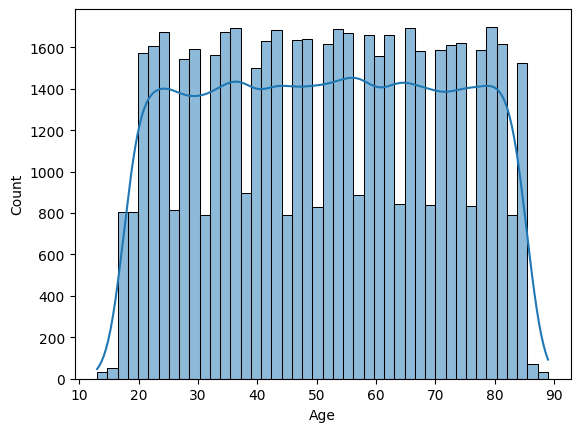

In [192]:
sns.histplot(df['Age'],kde=True)

In [195]:
def normalization(data):
    mins=np.min(data)
    maxs=np.max(data)
    for i in range(len(data)):
        data[i]=(data[i]-mins)/(maxs-mins)

    return data

In [196]:
normalization(df['Age'])

C:\Users\moham\AppData\Local\Temp\ipykernel_1812\1385888710.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[i]=(data[i]-mins)/(maxs-mins)
C:\Users\moham\AppData\Local\Temp\ipykernel_1812\1385888710.py:5: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.2236842105263158' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data[i]=(data[i]-mins)/(maxs-mins)


0        0.223684
1        0.644737
2        0.828947
3        0.197368
4        0.394737
           ...   
55495    0.381579
55496    0.631579
55497    0.328947
55498    0.394737
55499    0.526316
Name: Age, Length: 55500, dtype: float64

In [197]:
df.head()

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Male,Elective,Emergency,Urgent,A+,...,Cancer,Diabetes,Hypertension,Obesity,Aspirin,Ibuprofen,Lipitor,Paracetamol,Penicillin,Test Results
0,0.223684,0.800876,1.001558,0.995388,18856.281306,1,0,0,1,0,...,1,0,0,0,0,0,0,1,0,1
1,0.644737,1.001724,1.067529,1.005917,33643.327287,1,0,1,0,1,...,0,0,0,1,0,1,0,0,0,2
2,0.828947,0.871616,0.917658,1.000825,27955.096079,0,0,1,0,0,...,0,0,0,1,1,0,0,0,0,1
3,0.197368,1.131833,1.131833,1.005917,37909.782410,0,1,0,0,0,...,0,1,0,0,0,1,0,0,0,3
4,0.394737,1.143552,1.143552,1.000825,14238.317814,0,0,0,1,0,...,1,0,0,0,0,0,0,0,1,3


<Axes: xlabel='Doctor', ylabel='Count'>

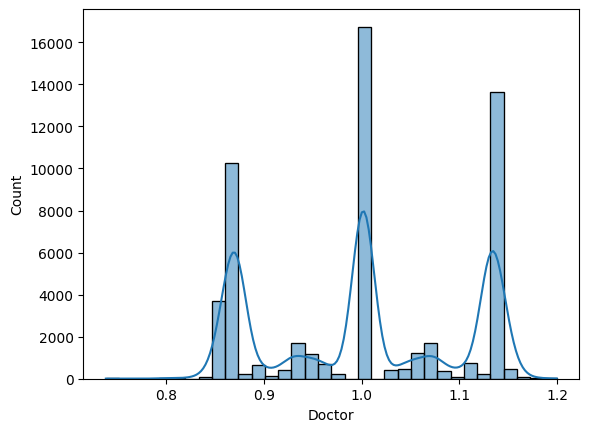

In [199]:
sns.histplot(df['Doctor'],kde=True)

In [200]:
normalization(df['Doctor'])

C:\Users\moham\AppData\Local\Temp\ipykernel_1812\1385888710.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[i]=(data[i]-mins)/(maxs-mins)
C:\Users\moham\AppData\Local\Temp\ipykernel_1812\1385888710.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[i]=(data[i]-mins)/(maxs-mins)
C:\Users\moham\AppData\Local\Temp\ipykernel_1812\1385888710.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[i]=(data[i]-mins)/(maxs-mins

0        0.135079
1        0.570975
2        0.288603
3        0.853347
4        0.878781
           ...   
55495    0.878781
55496    0.263068
55497    0.878781
55498    0.878781
55499    0.878781
Name: Doctor, Length: 55500, dtype: float64

In [201]:
df.head()

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Male,Elective,Emergency,Urgent,A+,...,Cancer,Diabetes,Hypertension,Obesity,Aspirin,Ibuprofen,Lipitor,Paracetamol,Penicillin,Test Results
0,0.223684,0.135079,1.001558,0.995388,18856.281306,1,0,0,1,0,...,1,0,0,0,0,0,0,1,0,1
1,0.644737,0.570975,1.067529,1.005917,33643.327287,1,0,1,0,1,...,0,0,0,1,0,1,0,0,0,2
2,0.828947,0.288603,0.917658,1.000825,27955.096079,0,0,1,0,0,...,0,0,0,1,1,0,0,0,0,1
3,0.197368,0.853347,1.131833,1.005917,37909.782410,0,1,0,0,0,...,0,1,0,0,0,1,0,0,0,3
4,0.394737,0.878781,1.143552,1.000825,14238.317814,0,0,0,1,0,...,1,0,0,0,0,0,0,0,1,3


<Axes: xlabel='Hospital', ylabel='Count'>

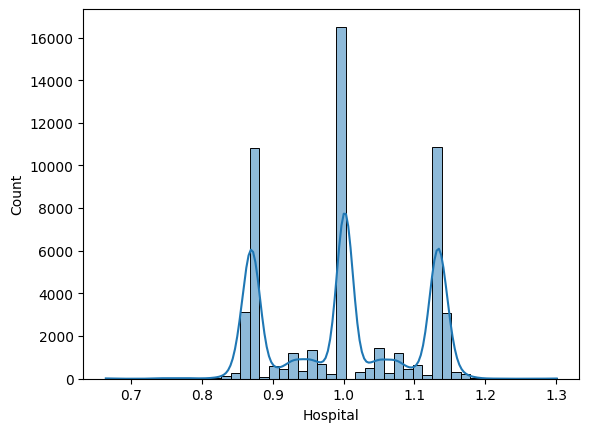

In [205]:
sns.histplot(df['Hospital'],kde=True)

In [207]:
from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler()
df['Hospital']=scaler.fit_transform(df[['Hospital']])

In [208]:
df.head()

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Male,Elective,Emergency,Urgent,A+,...,Cancer,Diabetes,Hypertension,Obesity,Aspirin,Ibuprofen,Lipitor,Paracetamol,Penicillin,Test Results
0,0.223684,0.135079,0.529807,0.995388,18856.281306,1,0,0,1,0,...,1,0,0,0,0,0,0,1,0,1
1,0.644737,0.570975,0.633421,1.005917,33643.327287,1,0,1,0,1,...,0,0,0,1,0,1,0,0,0,2
2,0.828947,0.288603,0.398035,1.000825,27955.096079,0,0,1,0,0,...,0,0,0,1,1,0,0,0,0,1
3,0.197368,0.853347,0.734417,1.005917,37909.782410,0,1,0,0,0,...,0,1,0,0,0,1,0,0,0,3
4,0.394737,0.878781,0.752823,1.000825,14238.317814,0,0,0,1,0,...,1,0,0,0,0,0,0,0,1,3


<Axes: xlabel='Insurance Provider', ylabel='Count'>

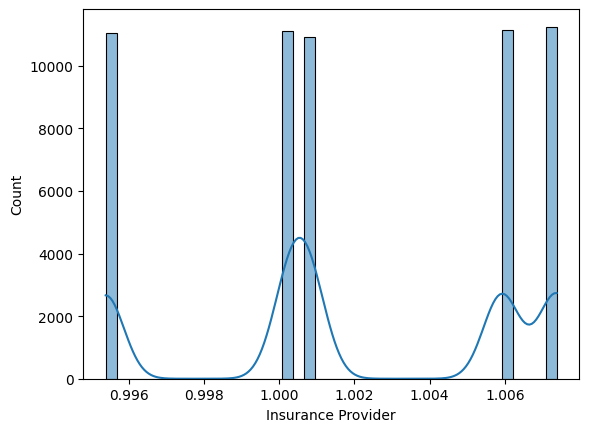

In [209]:
sns.histplot(df['Insurance Provider'],kde=True)

In [211]:
df['Insurance Provider'].unique()

array([0.99538837, 1.00591716, 1.0008247 , 1.00026966, 1.00737843])

## Standardization
Here I'm using standardization

In [212]:
def standardization(data):
    avg=np.mean(data)
    sd=np.std(data)
    return (data-avg)/sd

In [219]:
standardization(df['Insurance Provider'])

0       -1.531791
1        0.914199
2       -0.268852
3        0.914199
4       -0.268852
           ...   
55495   -1.531791
55496    1.253674
55497   -0.397796
55498    0.914199
55499   -0.268852
Name: Insurance Provider, Length: 55500, dtype: float64

In [214]:
df.head()

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Male,Elective,Emergency,Urgent,A+,...,Cancer,Diabetes,Hypertension,Obesity,Aspirin,Ibuprofen,Lipitor,Paracetamol,Penicillin,Test Results
0,0.223684,0.135079,0.529807,0.995388,18856.281306,1,0,0,1,0,...,1,0,0,0,0,0,0,1,0,1
1,0.644737,0.570975,0.633421,1.005917,33643.327287,1,0,1,0,1,...,0,0,0,1,0,1,0,0,0,2
2,0.828947,0.288603,0.398035,1.000825,27955.096079,0,0,1,0,0,...,0,0,0,1,1,0,0,0,0,1
3,0.197368,0.853347,0.734417,1.005917,37909.782410,0,1,0,0,0,...,0,1,0,0,0,1,0,0,0,3
4,0.394737,0.878781,0.752823,1.000825,14238.317814,0,0,0,1,0,...,1,0,0,0,0,0,0,0,1,3


<Axes: xlabel='Billing Amount', ylabel='Count'>

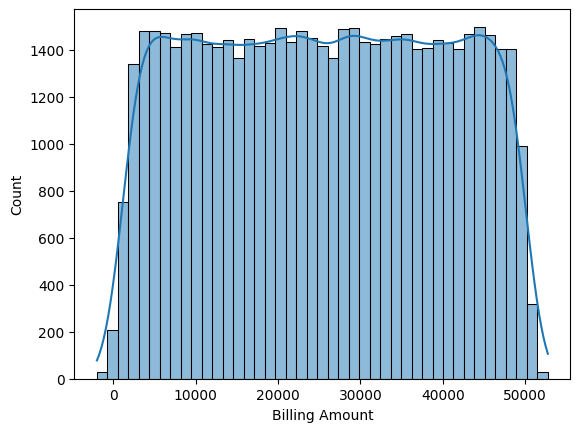

In [215]:
sns.histplot(df['Billing Amount'],kde=True)

In [220]:
from sklearn.preprocessing import StandardScaler
stdscaler=StandardScaler()
df['Billing Amount']=scaler.fit_transform(df[['Billing Amount']])

In [221]:
df.head()

,Age,Doctor,Hospital,Insurance Provider,Billing Amount,Male,Elective,Emergency,Urgent,A+,...,Cancer,Diabetes,Hypertension,Obesity,Aspirin,Ibuprofen,Lipitor,Paracetamol,Penicillin,Test Results
0,0.223684,0.135079,0.529807,0.000000,0.380933,1,0,0,1,0,...,1,0,0,0,0,0,0,1,0,1
1,0.644737,0.570975,0.633421,0.878126,0.650904,1,0,1,0,1,...,0,0,0,1,0,1,0,0,0,2
2,0.828947,0.288603,0.398035,0.453403,0.547053,0,0,1,0,0,...,0,0,0,1,1,0,0,0,0,1
3,0.197368,0.853347,0.734417,0.878126,0.728798,0,1,0,0,0,...,0,1,0,0,0,1,0,0,0,3
4,0.394737,0.878781,0.752823,0.453403,0.296622,0,0,0,1,0,...,1,0,0,0,0,0,0,0,1,3


<Axes: xlabel='Doctor', ylabel='Count'>

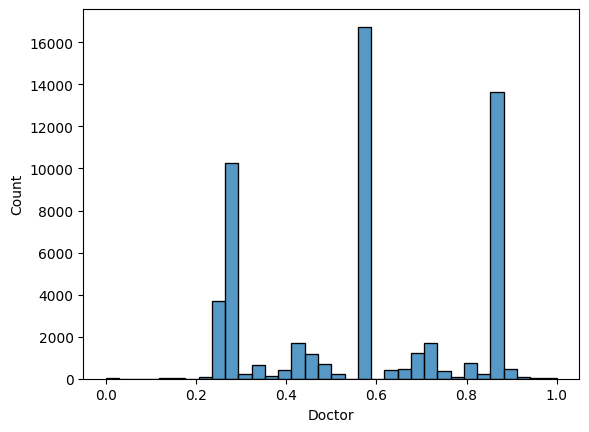